# Blind Separasjon
### Prosjekt 2, MA2501
Steffen Haug

## Innleiing
Prosjektet dreier seg om å separere signal.
Meir presist, går vi ut frå at vi har $d$ signal $\vec y_1, \vec y_2, \dots \vec y_d$,
kvart signal sampla $N$ gongar. Vi antar at signala er blanda på ein slik måta at signalet vi måler er ein vekta sum av av kjeldene,

$$
x_i = \sum w_i \vec y_i \text,
$$

som vi skriv elegant på matriseform:

$$
X = W Y \text.
$$

Her er $W$ ei $d \times d$-matrise med vekter $w_{ij}$, og $X$ er det målte, blanda signalet i form av ei $d \times N$-matrise.
Dette problemet er velkjend i det enklare tilfelle, der blandingsmatrisa er kjend.
I det tilfelle lar problemet seg løyse enkelt ved hjelp av lineær algebra.
Utfordringa i denne oppgåva er at blandingsmatrisa _ikkje er kjend_.

Dette gjev uendeleg mange _kandidatar_ til løysingar,
i den forstand at uansett val av $W$, so lenge den _ikkje er singulær_,
lar det seg gjere å finne ein $Y$ som oppfyller likninga.
Det er sjølvsagt klart at nesten ingen av desse "løysingane" er riktige,
i den forstand at $Y$ er kvalitativt "separert".
Det er klart at sidan uendeleg mange løysingar finnast,
og sidan kva som er den "riktige" løysinga i ein viss
forstand bestemmast kvalitativt, lar ikkje problemtet seg løyse reint
analytisk.

## Skildring av ICA-algoritma
Eit sentralt resultat i statistikken, _sentralgrenseteoremet_,
seier at gitt nokre betingelsar, vil summar av stokastiske variablar
tilnærme ei normalfordeling. Desse betingelsane er ikkje spesielt strenge,
og dersom fordelingane i utangspunktet er "fine" skjer konvergensen _svært raskt_.
"Fine" betyr i praksis at fordelingane har endeleg varians,
og _den same_ (endelege) forventingsverdien, \[0\] og ikkje mange lokale maksimum. \[1\]
Sidan krava er (relativt) enkle å tilfredsstille, kan vi bruke teoremet til å rettferdiggjere antagelsen om at dei blanda signala er _meir_ normalfordelte enn dei separerte signala.
Dette stemmer sjølvsagt berre dersom dei separerte signala ikkje sjølv var normalfordelte i utgangspunktet.

Prosedyra, samanfatta i korthet, baserer seg på å _måle_ kor normalfordelte signala er
som sannsynlighetsfordelingar, rekne ut _gradienten_ av dette målet og "følgje" gradienten til stadet med _lågast_ "gaussisk-het".

## Setup
Vi byrjar med å laste lydspora frå disk v. h. a. det utdelte biblioteket.
Funksjonar for å produsere normaliserte variantar av lydklippa er oppgitt:

In [4]:
import numpy as np
from numpy import linalg as LA
from scipy import linalg as SCLA
from wav_file_loader import read_wavefiles
import IPython.display as ipd

# these are provided, so no explanation will be given

def normalize_audio(data):
    abs_data = np.absolute(data)
    maximums = np.amax(abs_data,1)
    data = data / maximums.reshape((3,1))
    return data

def normalize_rowsums(A):
    the_sum = np.sum(A,1)
    A = A / the_sum.reshape((3,1))
    return A

def random_mixing_matrix(signals, observations):
    A = 0.25 + np.random.rand(observations, signals)
    return normalize_rowsums(A)

In [5]:
paths = ['audio/mix_1.wav', 'audio/mix_2.wav', 'audio/mix_3.wav']
data, sampling_rate = read_wavefiles(paths)
num_signals = data.shape[0]

data = normalize_audio(data)

In [64]:
ipd.display(ipd.Audio(data[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[2,:], rate=sampling_rate))

## Preprosessering
Eit av antagelsane for sentralgrenseteoremet er at fordelingane har same forventingsverdi $\mu < \infty$, og same varians $\sigma^2 < \infty$. \[0\]
Utan tap av generalitet kan vi velge $\mu = 0$ og $\sigma^2 = 1$. (Vi seier at det blanda signalet er tilnærma "standard normalfordelt")

Vi treng å transformere dei blanda signala inn i eit koordinatsystem der dette stemmer før vi startar iterasjonen.
Whitening-transformasjonen er oppgitt, så eg gjev ikkje noko forklaring på _korleis_ den fungerer; det sentrale er kva transformasjonen _gjer_ med signala.

### Sentrering
Sentrerings-transformasjonen er enkel: Ved å trekke
gjennomsnittet av ei rad $\mu = \mu(\vec x_i)$ frå rada $\vec x_i$ vert
kvar rad etterlatt med $\mu = 0$.

### Whitening-transformasjon
"Whitening"-transformasjonen opererer på ei matrise på
den måten at kovariansematrisa er identitetsmatrisa,
med andre ord er det slik at

$$
\mathrm{Cov}(\vec x_i, \vec x_j) = \delta_{ij}.
$$

Altso er

$$
\mathrm{Cov}(\vec x_i, \vec x_j) = 0 \quad i \neq j,
$$

som betyr at signala er "ukorrelerte" etter transformasjonen.
Vi har også at

$$
\mathrm{Cov}(\vec x_i, \vec x_i)
\equiv \mathrm{Var}(\vec x_i) = 1.
$$

Etter preprosesseringssteget er det altso slik at signala er sentrerte ($\mu = 0$) og ukorrelerte ($\mathrm{Cov} = 0$) med varians $\mathrm{Var} = 1$.

In [6]:
def center_rows(Z):
    ''' center the rows of Z around zero
    parameters:
        Z    any array (that has rows i guess)
    returns:
        Zc   the centered array
    '''
    # By subtracting the mean of a row from every element,
    # the row is left with zero mean
    ZcT = Z.T - np.mean(Z, axis=1)
    return ZcT.T

def whiten_rows(Zc):
    ''' whitening the rows
    parameters:
        Zc   a centered array
    returns:
        Zcw  a centered and whitened array
    '''
    C = np.cov(Zc)
    # compute the "square root inverse" using the
    # singular value decomposition
    U, S, _ = LA.svd(C, full_matrices=False)
    sqiC = U @ np.diag(1/np.sqrt(S)) @ U.T
    
    Zcw = sqiC @ Zc
    return Zcw

## Mål på gaussisk-het
Det er oppgitt at "kurtose" er eit mål på kor gaussisk noko er. Uttrykket lar seg enkelt derivere for hand, og dermed er gradienten kjent utan at der er behov for å bruke dyrebare prosessorsyklusar på å estimere denne.

In [7]:
def K(u):
    return 4 * u**3

def dKdu(u):
    return 12 * u**2

Negentropi, eit anna mål på gaussisk-het er oppgitt i heftet.
Denne brukar eksponential-funksjonen, og er mykje treigare.
Eg går ut frå at eksponentialfunkjsonen er estimert v. h. a. ei Taylor-utvikling eller noko liknande,
og dette innbér langt fleire multiplikasjonar og addisjonar.

In [8]:
def N(u):
    return u * np.exp(-u**2 / 2)

def dNdu(u):
    return (u**2 - 1) * -np.exp(-u**2 / 2)

## Hovuditerasjon
Iterasjonen går som forklart innleiingsvis.
Funksjonen er skriven slik at ein kan oppgje kva mål på gaussisk-het som skal brukast,
men Kurtose er standard-argument fordi denne er raskast.
(og eg kan ikkje høyre stor forskjell på resultatet dersom eg bruker negentropi uansett)

Det einaste som ikkje er klart frå innleiiinga er val av startpunkt:
Det er ikkje nødvendigvis garantert at algoritma konvergerer for alle val av startmatriser.
(det er i alle fall ikkje bevist)
I iterasjonen startar eg berre med ei tilfeldig matrise, gitt av `random_mixing_matrix`. Det kan tenkast at algoritma ikkje konvergerer, og det kan tenkast at algoritma konvergerer til eit lokalt minimum.

In [9]:
def normalize_rownorms(Z):
    ''' transform Z s. t. every row has norm 1
    parameters:
        Z     the matrix to transform
    returns:
        Znorm the normalized matrix
    '''
    the_norms = LA.norm(Z, axis=1)
    Znorm = Z / the_norms.reshape(Z.shape[0], 1)
    return Znorm

def decorrelate_weights(W):
    ''' transform W s. t. the rows that have
        Cov = 0, essentially removing correlation
        between rows.
    parameters:
        w     the matrix to transform
    returns:
        Wd    the decorrelated matrix
    '''
    WWT = W @ W.T
    U, S, _ = LA.svd(WWT, full_matrices=False)
    sqiWWT = U @ np.diag(1/np.sqrt(S)) @ U.T
    Wd = sqiWWT @ W
    return Wd

def update_W(Wk, Zcw, f=K, df=dKdu):
    ''' compute the next iteration of weights sequence
    parameters:
        Wk    The previous iteration of weights
        Zcw   The (centered and whitened) rows
        f     The non-gaussianness measure (Kurtusis by def.)
        df    The gradient of the non-gaussianness measure
    returns:
        W_k1  W_(k+1), the next iteration of wights
    '''
    s = Wk @ Zcw
    G, dG = f(s), df(s)
    E = np.mean(dG, axis=1)
    Wp = 1/Zcw.shape[1] * G @ Zcw.T - np.diag(E) @ Wk
    Wp = normalize_rownorms(Wp)
    W_k1 = decorrelate_weights(Wp)
    return W_k1

def measure_of_convergence(W1, W2):
    ''' measures the "distance" between two matrices.
        if the distance is small, then the convergence
        is slow, so we can assume we are close to the
        (or _a_) solution
    parameters:
        W1, W2   matrices to measure distance between
    returns
        delta    the distance between them
    '''
    return np.amax(1 - np.sum(W1 * W2, axis=1))

## Løkka

In [11]:
def fast_ICA(Z, tol=1e-10, max_iter=100, f=K, df=dKdu): 
    ''' independent component analysis.
        iteratively searches for an approximation to a solution
        to the cocktail party problem.
    parameters:
        Z         the signals
        tol       the tolerance, beyond which we search no more
        max_iter  the maximum number of iterations
        f         the measure of non-gaussianness
        df        the gradient of said measure
    returns:
        Zica      the separated signals
        timed_out whether the # of iterations reached max_iter
    '''
    Zc  = center_rows(Z)
    Zcw = whiten_rows(Zc)
    
    Wn = random_mixing_matrix(len(Z), len(Z))
        
    for i in range(max_iter):
        Wnm1, Wn = Wn, update_W(Wn, Zcw, f=f, df=df)
        d = measure_of_convergence(Wnm1, Wn)
        if d < tol:
            break
            
    timed_out = i >= max_iter - 1
    
    return Wn @ Zcw, timed_out

## Utdelte signal

In [26]:
import time

start = time.time()
Zica, _ = fast_ICA(data)
end = time.time()
print((end-start)*1000, "ms")

ipd.display(ipd.Audio(Zica[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(Zica[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(Zica[2,:], rate=sampling_rate))

94.02203559875488 ms


Dette resultatet er svært positivt. Signala er klart separert.
Lydklippa har litt kvit støy, men det er ikkje klart om dette skyldast
algoritma eller den opprinnelege kvaliteten på lydklippa.

--- BENCHMARK ---
100 trials. Converged: 100, Diverged: 0.
min time:    40.57598114013672
max time:    114.23397064208984
avg time:    57.9147744178772
std. dev:    10.142562065663913


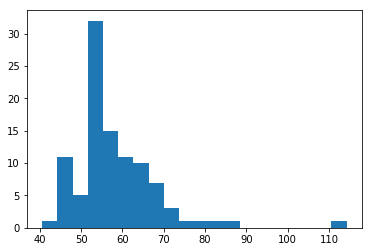

In [38]:
import matplotlib.pyplot as plt

NUM_TRIALS = 100

M = float('0')
m = float('inf')
ts = []

conv = 0
div = 0

for i in range(NUM_TRIALS):
    mix = random_mixing_matrix(len(data), len(data))
    data_mixed = normalize_audio(mix @ data)
    
    start = time.time()
    Zica, timeout = fast_ICA(data_mixed)
    end = time.time()
    
    t = (end - start) * 1000 # ms conversion    
    ts.append(t)
    
    if timeout:
        div += 1
    else:
        conv += 1

    
M = max(ts)
m = min(ts)  
mu = np.mean(ts)
sig = np.std(ts)

print("--- BENCHMARK ---")
print("{} trials. Converged: {}, Diverged: {}."
     .format(NUM_TRIALS, conv, div))
print("min time:   ", m)
print("max time:   ", M)
print("avg time:   ", mu)
print("std. dev:   ", sig)

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
ax.hist(ts, bins=20)
plt.show()

På ei spesifikk datamaskin, under spesifikke forhold oppnådde algoritma følgjande resultat:
```
--- BENCHMARK ---
500 trials. Converged: 500, Diverged: 0.
min time:    85.449
max time:   209.734
avg time:   122.644
std. dev:    20.254
```
og på ei anna maskin:
```
--- BENCHMARK ---
500 trials. Converged: 500, Diverged: 0.
min time:    40.961
max time:   123.450
avg time:    61.452
std. dev:    12.422
```

som framstår som ganske bra, men det er vanskeleg å seie utan noko å samanlikne med. Vel å merke er standardavviket ganske stort, noko som indikerer at val av startmatrise har mykje å seie.

Kanskje overraskande, så konvergerte algoritma for alle 500 startmatrisene. Likevel så er det ikkje sikkert at dei konvergerte til den riktige løysinga, (dei kan til dømes tenkast å sitte fast i lokale minimum) men eg har ikkje tenkt til å høyre på lydklippa tusan gongar for å finne ut det.

Ein måte å finne ut dette på er eventuelt å samanlikne resultata dei med ei matrise som ein veit er separert riktig.
Dette kan ein gjere v. h. a. ein eller anna matrise-norm og ein eller annan liten $\varepsilon$ som bestemmer kor nærme den de-facto riktige matrisa eit signal må vera for å ha "konvergert riktig".

### Eigne signal
<font color='red'>Forsiktig hvis du har på høg lyd; 8-bit konverteringa har fullstendig maltraktert lydkvaliteten, så det høyrast grusomt ut</font>

Eg ønsker å forsøke å separere tre eigne lydklipp som liknar meir på kvarandre enn klippa
som vart utdelt. Grunnen til at dette er interresant er at signal ein ønsker å skilje i
praksis gjerne liknar på kvarandre.

Kanskje signalet er vibrasjonar i ulike punkt i ei maskin eller noko som ikkje ein gang lar seg gjere for menneske å skilje frå kvarandre. Er algoritma like god på signal som _liknar kvarandre?_

For å teste dette har eg tatt opptak av nokre gitarklipp. Alle er spelt inn på same gitar, med same mikrofom, i det same rommet. (Riktig nok spelar eg ikkje det same i kvart klipp, så signala er ikkje *so like* kvarandre)

In [81]:
paths = [
    'lyd/8bit/t2.wav', 
    'lyd/8bit/t4.wav', 
    'lyd/8bit/t1.wav'
]
data, sampling_rate = read_wavefiles(paths)
num_signals = data.shape[0]

ipd.display(ipd.Audio(data[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[2,:], rate=sampling_rate))

In [82]:
mix = random_mixing_matrix(3, 3)
data = normalize_audio(mix @ data)

ipd.display(ipd.Audio(data[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[2,:], rate=sampling_rate))

In [83]:
import time

start = time.time()
Zica, _ = fast_ICA(data)
end = time.time()
print((end - start)*1000, "ms")

ipd.display(ipd.Audio(Zica[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(Zica[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(Zica[2,:], rate=sampling_rate))

2382.65323638916 ms


Dette gjekk også ganske bra, sjøv med all støyen.

## Eit eksperiment med "tynt" signal
I røynda er det kanskje slik at eit signal er stille i periodar.
For å undersøkje dette har eg spelt inn eit klipp som kun inneheld knipsing. Hypotesa er at i "tomrommet" mellom knipsinga inneheld miksen berre signal frå dei to andre kjeldene, så dersom ein betraktar miksen kun som ei sannsynsfordeling vil knipsinga (som for det meste er heilt stille) vere statistisk insignifikant, og dette kan gje utslag på resultatet.

In [86]:
paths = [
    'lyd/8bit/t2.wav', 
    'lyd/8bit/t4.wav', 
    'lyd/8bit/knips.wav'
]
data, sampling_rate = read_wavefiles(paths)
num_signals = data.shape[0]

ipd.display(ipd.Audio(data[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[2,:], rate=sampling_rate))

In [87]:
mix = random_mixing_matrix(3, 3)
data = normalize_audio(mix @ data)

ipd.display(ipd.Audio(data[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(data[2,:], rate=sampling_rate))

In [88]:
import time

start = time.time()
Zica, _ = fast_ICA(data)
end = time.time()
print((end - start)*1000, "ms")

ipd.display(ipd.Audio(Zica[0,:], rate=sampling_rate))
ipd.display(ipd.Audio(Zica[1,:], rate=sampling_rate))
ipd.display(ipd.Audio(Zica[2,:], rate=sampling_rate))

20081.01224899292 ms


Dette gjekk ikkje! Dette er til ein viss grad rein spekulasjon, men ein kan tenkje seg at
i tilfelle eit signal er "tynt", slik som knipsinga som er stille mesteparten av tida,
så vil to signal dominere miksen fullstendig, så i praksis har vi berre to signal!

## Diskusjon
I det siste eksperimentet dominerer to av signala fullstendig, og det viser seg at i dette tilfelle fungerer algoritma ikkje. Med andre ord har algoritma strenge begrensingar på _kva_ den er egna til.
Det er ikkje so vanskeleg å forstille seg kvifor dette skjer:
Dersom eitt av signala er (statistisk) insignifikant i miksen, prøver vi essensielt å splitte to signal i tre! Dette er sjølvsagt absurd.
I praksis set dette svært strenge krav til kva signal algoritma kan brukast til å skilje; mange signal i røynda er stille i periodar,
eller varierer i intensitet i periodar.

I tillegg til dette er det ikkje klart at dei fleste signal _ikkje_ er normalfordelte. Mange signal har opphav i lineærkombinasjonar av fysiske variablar (som er summar) til dømes "summen" av vibrasjonar i eit skråg, der vibrasjonen har bidrag frå bølgjer, vind, motorar og propellar som snurrar, og so vidare. Derosom betingelsane for sentralgrenseteoremet ellers er oppfyld vil slike situasjonar framstå som normalfordelte.

Når det er sagt, har vi sett to eksempel på at algoritma fungerer svært godt dersom krava *er* oppfylde: I tilfeller der algoritma fungerer, produserer den resultat raskt, og resultata er kvalitativt gode.

## Kjeldeliste
\[0\] R. J. Larsen & M. L. Marx *An introduction to Mathematical Statistics and Its Applications*

\[1\] Dette vart sagt høgt i ei forelesning i TMA4245 Statistikk, beklager at dette ikkje er ei spesielt god kjelde